#### Import Modules

In [71]:
from PIL import Image, ImageOps
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import image
import glob, os
import math
from scipy import spatial
import random 

#### Function: Get a numpy array from an image file location

In [45]:
def load_image(source : str) -> np.ndarray:
    with Image.open(source) as im:
        im_arr = np.asarray(im)
    return im_arr

#### Load our main image

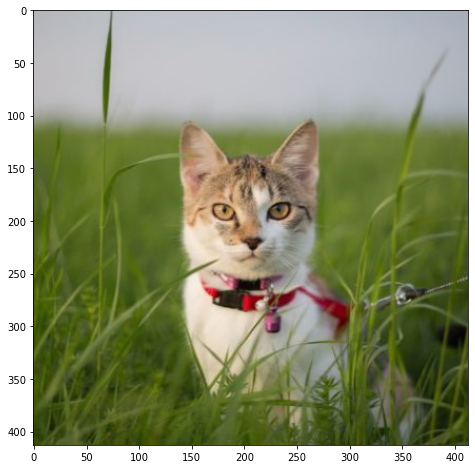

In [361]:
plt.figure(figsize=(8,8))
im_arr = load_image('C:/Users/User/Pictures/cat.jpg')
image = Image.fromarray(im_arr)
plt.imshow(image)
plt.show()

#### Store width and height of original image

In [362]:
width = im_arr.shape[0]
height = im_arr.shape[1]

#### Set the target resolution
This will be the resolution of the mosiac template and the number of images the final image's width and height will be equal to

In [363]:
target_res = (100, 100) ## Number of images to make up final image (width, height)

#### Create a template for mosaic
Index slice the image, using the step for rows and columns to divide the resolution

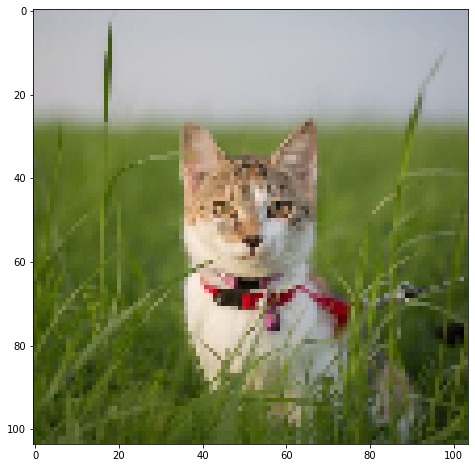

In [377]:
plt.figure(figsize=(8,8))
mos_template = im_arr[::(height//target_res[0]),::(height//target_res[1])]
plt.imshow(Image.fromarray(mos_template))
plt.show()

#### Number of images required to fill mosaic

In [378]:
mos_template[:,:, -1].size

10816

#### Create a list of all images as np arrays

In [379]:
images = []

from pathlib import Path


directory = 'C:/Users/User/Pictures/nature'

files = Path(directory).glob('*')
for file in files:
    im = load_image(file)
    images.append(im)



#### Function: resize an image to given size

In [381]:
def resize_image(img : Image, size : tuple) -> np.ndarray:
    resz_img = ImageOps.fit(img, size, Image.ANTIALIAS, centering=(0.5, 0.5))
    return np.array(resz_img)
def grayscale_image(img: Image) -> np.ndarray:
    resz_img = ImageOps.grayscale(img)
    return np.array(resz_img)

#### Set mosiac tile size


In [382]:
mosaic_size = (50, 50) 
images = [resize_image(Image.fromarray(i), mosaic_size) for i in images]


#### Number of images in list

In [383]:
len(images)




112

#### Let's take a look at one of the mosaic images

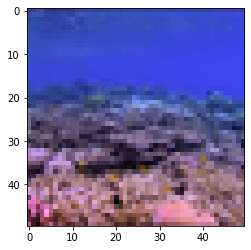

In [398]:
plt.imshow(Image.fromarray(images[55]))


plt.show()

#### Convert list to np array

In [399]:
images_array = np.asarray(images)
images_array.shape

(112, 50, 50, 3)

#### Get mean of RGB values for each image
This will store the mean Red, Green and Blue values of each mosaic image

In [400]:
image_values = np.apply_over_axes(np.mean, images_array, [1,2]).reshape(len(images),3)
image_values

array([[181.2992,  51.104 ,  50.2672],
       [ 76.57  , 101.198 , 139.4404],
       [ 64.3816,  61.0428,  62.76  ],
       [ 68.0504,  64.4568,  66.9204],
       [112.5132,  67.83  ,  47.542 ],
       [124.452 ,  82.552 ,  53.1952],
       [ 92.4804, 101.0928, 114.2372],
       [ 71.824 , 150.2872, 153.5324],
       [ 32.5316,  38.4072,  44.6652],
       [ 44.3032,  46.1032,  41.096 ],
       [ 44.51  ,  46.514 ,  42.756 ],
       [ 52.5632,  53.2644,  47.594 ],
       [ 63.964 ,  62.236 ,  38.0244],
       [ 83.4616,  76.97  ,  52.6604],
       [107.7604,  98.3976,  73.9344],
       [ 71.582 ,  67.684 ,  46.912 ],
       [153.7356, 106.7444,  89.3204],
       [161.0036, 115.0708,  97.9392],
       [ 30.164 ,  47.8196,  69.7544],
       [ 30.9228,  47.9272,  70.1492],
       [ 94.9264,  63.8984,  42.9616],
       [102.1436,  69.796 ,  47.4916],
       [106.7224,  74.8932,  53.82  ],
       [ 68.634 ,  69.5156,  70.3176],
       [ 67.1772,  67.9948,  68.692 ],
       [101.142 ,  80.421

#### Set KDTree for image_values

In [387]:
tree = spatial.KDTree(image_values)

#### Store the indices of best match images


In [401]:
image_idx = np.zeros(target_res, dtype=np.uint32)


for i in range(target_res[0]):
    for j in range(target_res[1]):
        
        template = mos_template[i, j]
        
        match = tree.query(template, k=20)
        pick = random.randint(0, 19)
        image_idx[i, j] = match[1][pick]

#### Loop through the best match indices, retrieve the matching image and add it to the canvas


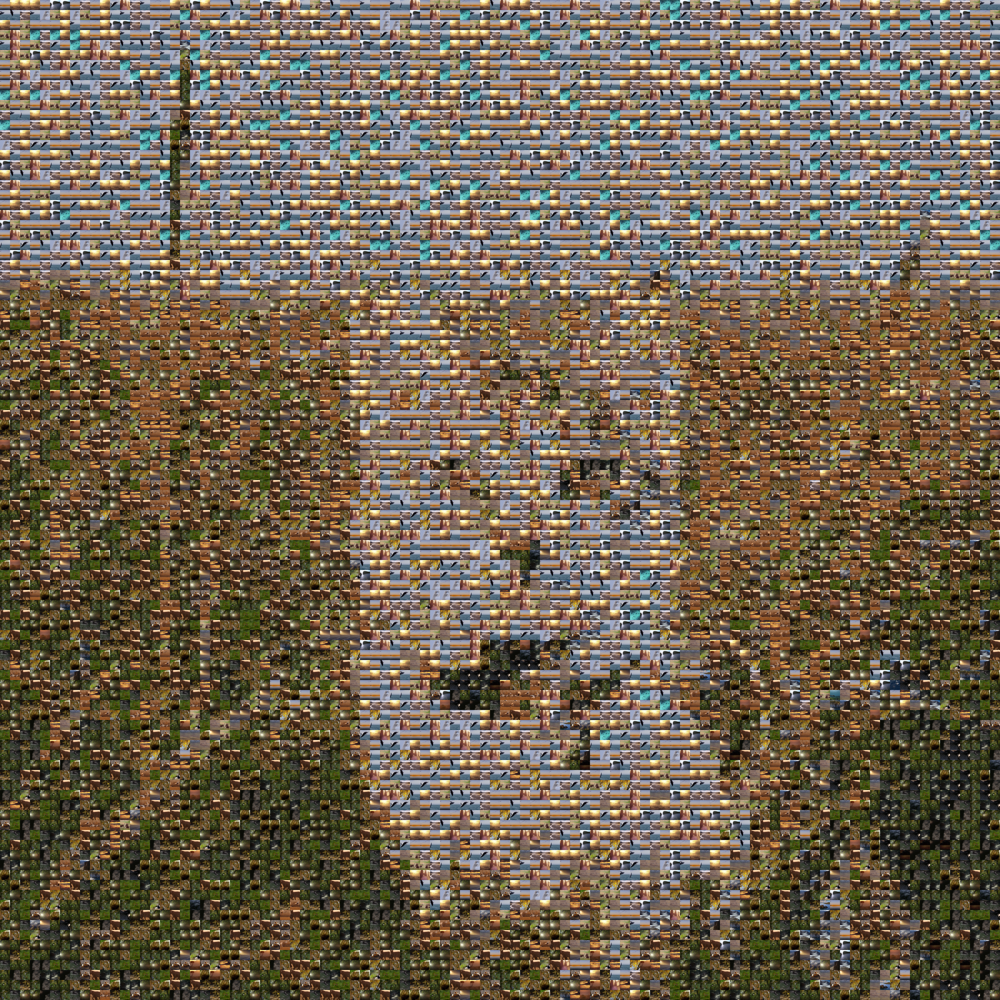

In [402]:
canvas = Image.new('RGB', (mosaic_size[0]*target_res[0], mosaic_size[1]*target_res[1]))

for i in range(target_res[0]):
    for j in range(target_res[1]):
        arr = images[image_idx[j, i]]
        x, y = i*mosaic_size[0], j*mosaic_size[1]
        im = Image.fromarray(arr)
        canvas.paste(im, (x,y))
        
canvas

#### Save output

In [19]:
# canvas.save('../Images/Exports/export.jpg')